In [13]:
import create_n_crop_bounding_box as c
import matplotlib.pyplot as plt
import skimage.util as util
import skimage.io as io
import numpy as np
import os as os 
import skimage as sk
import skimage.color as cl
import skimage.filters as filt 
import scipy.ndimage.filters as fil
import skimage.morphology as morph
import skimage.segmentation as seg
import skimage.measure as measure
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn import svm
from sklearn.naive_bayes import GaussianNB
import skimage.feature as ft

# Helper Functions for Feature Extraction

In [14]:
plt.rcParams['image.cmap'] = 'gray'

def element_counter(region):
    sum_val=0
    for i in range(region.shape[0]):
        for j in range(region.shape[1]):
            if region[i][j]==1 or  region[i][j]==True:
                sum_val=sum_val+1     
    return sum_val 

def HoCS(B, min_scale, max_scale, increment, num_bins):
    '''
    Computes a histogram of curvature scale for the shape in the binary image B.  
    Boundary fragments due to holes are ignored.
    :param B: A binary image consisting of a single foreground connected component.
    :param min_scale: smallest scale to consider (minimum 1)
    :param max_scale: largest scale to consider (max_scale > min_scale)
    :param increment:  increment on which to compute scales between min_scale and max_scale
    :param num_bins: number of bins for the histogram at each scale
    :return: 1D array of histograms concatenated together in order of increasing scale.
    '''
    concatenated_histograms=[]
    current_scale = min_scale
    while(current_scale<=max_scale):
        iterative_histogram=[]    
        C=morph.disk(current_scale)
        Label_B= morph.label(B, connectivity=1)

        B_boundaries = seg.find_boundaries(Label_B,connectivity=1,mode='inner')
        Boundry_points = np.where(B_boundaries>0)        
        R_points = np.transpose(np.vstack(Boundry_points))
        
        kp=[]
        area_C = element_counter(C)
        for i in range(len(R_points)):
            R_region = B[R_points[i][0]-current_scale:R_points[i][0]+current_scale+1,R_points[i][1]-current_scale:R_points[i][1]+current_scale+1] 
            area_RinC=0
            for j in range(R_region.shape[0]):
                for k in range(R_region.shape[1]):
                    if C[j][k] == 1 and R_region[j][k] == True:
                        area_RinC = area_RinC+1 
            
            kp.append(area_RinC/area_C)
      
        iterative_histogram,notneeded=np.histogram(kp,bins=num_bins,range=(0.0,1.0))
        iterative_histogram = iterative_histogram/len(kp)
        
        for l in range(0,len(iterative_histogram)):
            concatenated_histograms.append(iterative_histogram[l])
        
        current_scale=current_scale+increment
        
    return concatenated_histograms
 
def segment_clump(I):
    '''
    Segment a leaf image.
    :param I: Color leaf image to segment.
    :return: Logical image where True pixels represent foreground (i.e. leaf pixels).
    '''

    hsv_image = cl.rgb2hsv(I)
    #hsv_image = filt.gaussian(hsv_image,sigma=2.5)
    segmented_image = np.zeros((hsv_image.shape[0],hsv_image.shape[1]))
    segmented_image = np.logical_and(hsv_image[:,:,0]>=0.19, hsv_image[:,:,0]<=0.37)
    segmented_image=segmented_image.astype(bool)
    
    segmented_image = morph.binary_opening(segmented_image,selem = morph.square(4))
    segmented_image = morph.binary_closing(segmented_image,selem = morph.square(3))
    segmented_image = morph.remove_small_objects(segmented_image,min_size=1500)
        
    return segmented_image

def segregate_connected_components(labeled_image,total_components):
    connected_components =[]
    segregated_image = labeled_image.copy()
    for i in range(1,total_components+1):
        segregated_image = labeled_image.copy()
        for x in range(0,labeled_image.shape[0]):
            for y in range(0,labeled_image.shape[1]):
                if(labeled_image[x][y]==i):
                    segregated_image[x][y]=1
                else:
                    segregated_image[x][y]=0
        connected_components.append(segregated_image)
    return connected_components
                    

def regional_statistics(segmented_image):
    
    '''
    I: Segmented Image
    Creates a connected component image of the segmented regions
    returns the number of connected components, average and total size(no of pixels) of connected components  
    '''
    histogram_list = []
    histogram_curvature = []
    labeled_image = measure.label(segmented_image,neighbors=8)
    
    connected_components = segregate_connected_components(labeled_image,np.amax(labeled_image))
    print("Number of Connected Components: "+str(np.amax(labeled_image)))
    
    for i in range(0,len(connected_components)):
        histogram_cc = HoCS(connected_components[i],5,6,5,7)
        for j in range(0,len(histogram_cc)):
            histogram_list.append(histogram_cc[j])
    
    #histogram_list = np.divide(histogram_list,np.amax(labeled_image))
    histogram_curvature,notneeded = np.histogram(histogram_list,bins=7,range=(0.0,1.0))
    
#     print("HOCs")
#     print(histogram_curvature)
#     print("HOC Length:"+str(len(histogram_curvature)))
        
    return histogram_curvature


# Helper Function LBP and GLCM

In [15]:
def GLCM_feature(Image):
    
    Image =sk.img_as_ubyte(cl.rgb2gray(Image))
    
    plt.figure()
    plt.imshow(Image)
    plt.show()
    
    glcm_feature=0
    glcms = ft.greycomatrix(Image,distances=[2,4,8,16,32,48,64],angles=[0.785398,1.5708,3.142],normed=True)
    glcm_feature_1 = ft.greycoprops(glcms, prop='contrast')
    glcm_feature_2 = ft.greycoprops(glcms, prop='dissimilarity')
    glcm_feature_3 = ft.greycoprops(glcms,prop='correlation')
    
    glcm_feature_1 = np.mean(glcm_feature_1,axis=1)
    glcm_feature_2 = np.mean(glcm_feature_2,axis=1)
    glcm_feature_3 = np.mean(glcm_feature_3,axis=1)
    
    glcm_feature = np.concatenate((glcm_feature_1,glcm_feature_2,glcm_feature_3),axis=None) 

    return glcm_feature

def get_LBP(training_image):
    
    training_image = cl.rgb2gray(training_image)
    Linv_LBP_image=0
    Var_LBP_image=0
    Linv_iterative_histogram=[]
    Var_iterative_histogram=[]
    iterative_histogram=[]
    
    Linv_LBP_image = ft.local_binary_pattern(training_image,P=32,R=3,method='uniform')
    Var_LBP_image = ft.local_binary_pattern(training_image,P=32,R=3,method='var')    
    Linv_iterative_histogram,notneeded = np.histogram(Linv_LBP_image,bins=10,range=(0,9))
    Var_iterative_histogram,notneeded = np.histogram(Var_LBP_image,bins=16,range=(0,7000))
    iterative_histogram = np.concatenate((Linv_iterative_histogram,Var_iterative_histogram),axis=None)
        
    return iterative_histogram

# Feature Extraction For Classifier Training

Image File name:IMG_4426.JPG


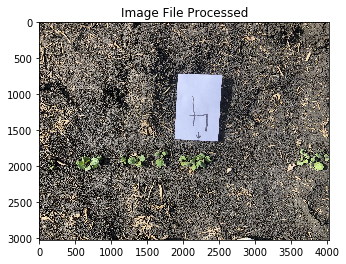

Processed Image: IMG_4426.JPG Number of Labels: 1
Number of Connected Components: 1


D:\Anaconda_Installed\lib\site-packages\skimage\util\dtype.py:122: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


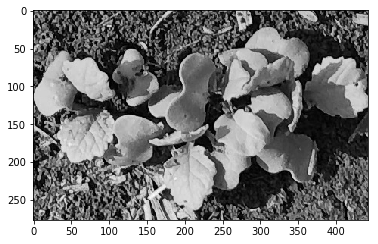

D:\Anaconda_Installed\lib\site-packages\skimage\feature\texture.py:109: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  if np.issubdtype(image.dtype, np.float):


Image File name:IMG_4428.JPG


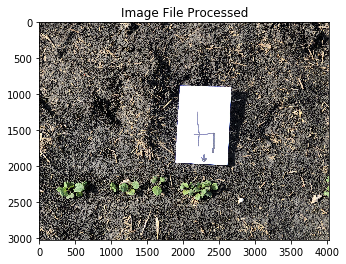

Processed Image: IMG_4428.JPG Number of Labels: 1
Number of Connected Components: 2


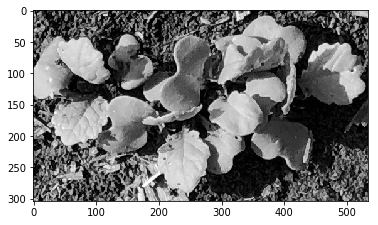

Image File name:IMG_4430.JPG


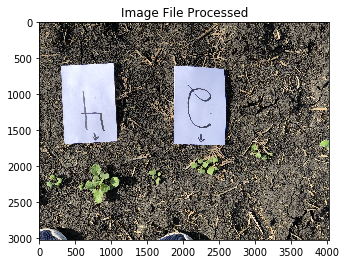

Processed Image: IMG_4430.JPG Number of Labels: 2
Number of Connected Components: 2


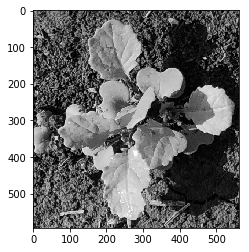

Number of Connected Components: 2


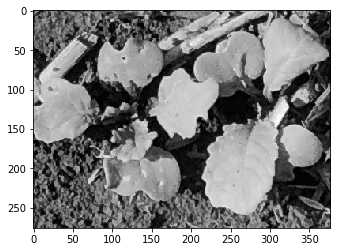

Image File name:IMG_4433.JPG


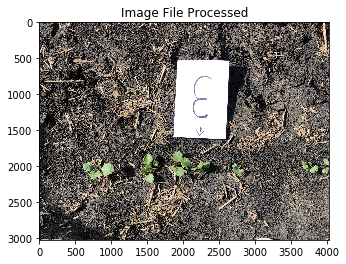

Processed Image: IMG_4433.JPG Number of Labels: 1
Number of Connected Components: 5


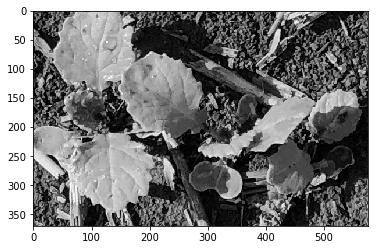

Image File name:IMG_4435.JPG


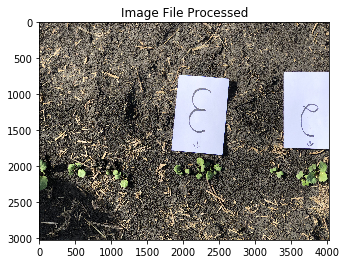

Processed Image: IMG_4435.JPG Number of Labels: 2
Number of Connected Components: 4


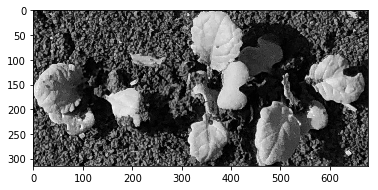

Number of Connected Components: 2


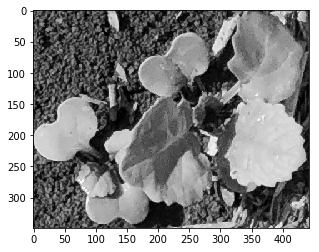

Image File name:IMG_4436.JPG


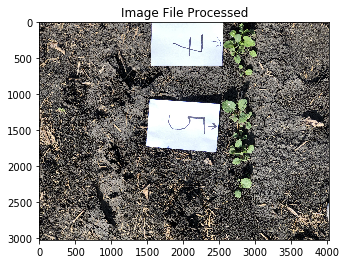

Processed Image: IMG_4436.JPG Number of Labels: 2
Number of Connected Components: 3


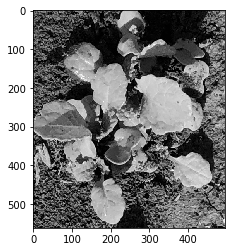

D:\Anaconda_Installed\lib\site-packages\numpy\lib\function_base.py:780: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
D:\Anaconda_Installed\lib\site-packages\numpy\lib\function_base.py:781: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


Number of Connected Components: 8


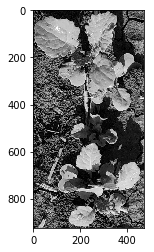

Image File name:IMG_4438.JPG


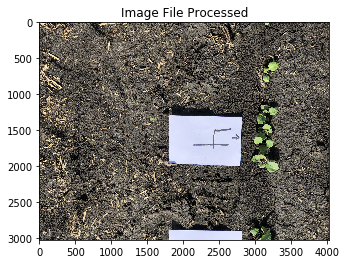

Processed Image: IMG_4438.JPG Number of Labels: 1
Number of Connected Components: 3


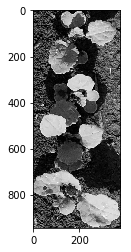

Image File name:IMG_4440.JPG


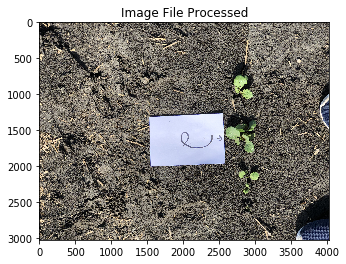

Processed Image: IMG_4440.JPG Number of Labels: 1
Number of Connected Components: 1


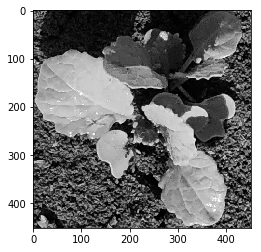

Image File name:IMG_4442.JPG


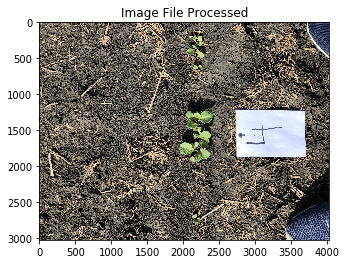

Processed Image: IMG_4442.JPG Number of Labels: 1
Number of Connected Components: 2


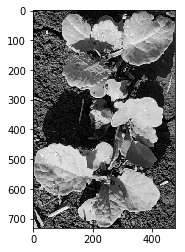

Image File name:IMG_4444.JPG


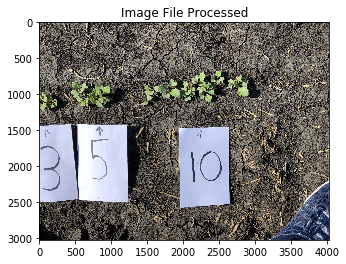

Processed Image: IMG_4444.JPG Number of Labels: 3
Number of Connected Components: 2


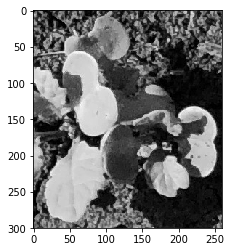

Number of Connected Components: 5


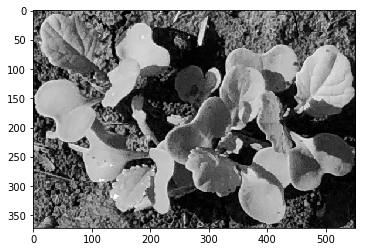

Number of Connected Components: 9


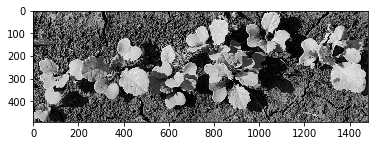

Image File name:IMG_4446.JPG


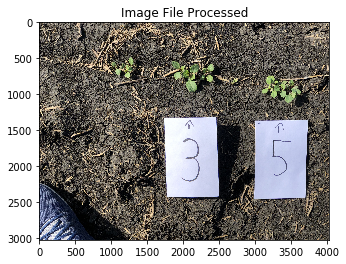

Processed Image: IMG_4446.JPG Number of Labels: 2
Number of Connected Components: 8


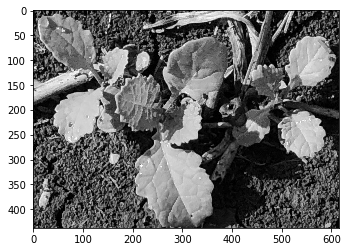

Number of Connected Components: 2


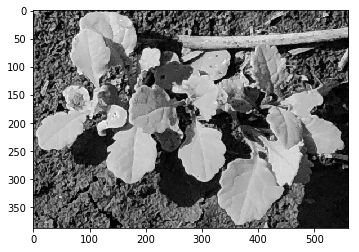

Image File name:IMG_4448.JPG


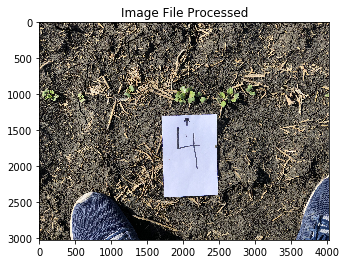

Processed Image: IMG_4448.JPG Number of Labels: 1
Number of Connected Components: 2


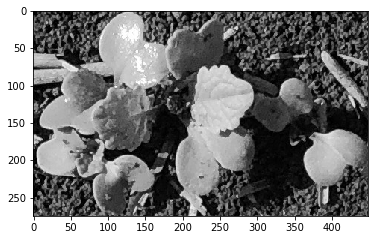

Image File name:IMG_4451.JPG


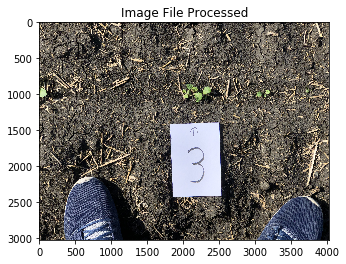

Processed Image: IMG_4451.JPG Number of Labels: 1
Number of Connected Components: 5


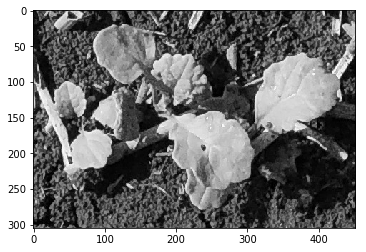

Image File name:IMG_4452.JPG


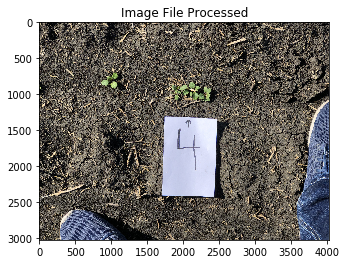

Processed Image: IMG_4452.JPG Number of Labels: 1
Number of Connected Components: 5


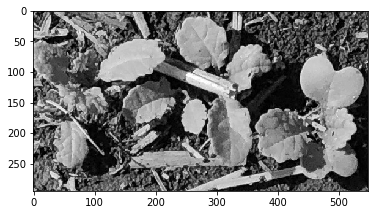

Image File name:IMG_4456.JPG


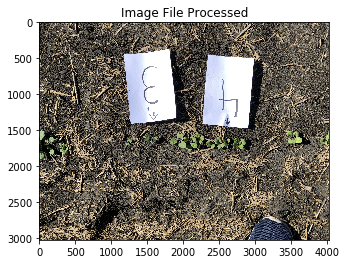

Processed Image: IMG_4456.JPG Number of Labels: 2
Number of Connected Components: 3


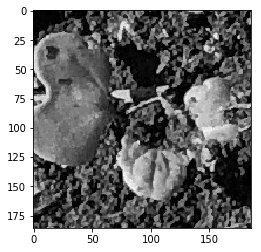

Number of Connected Components: 4


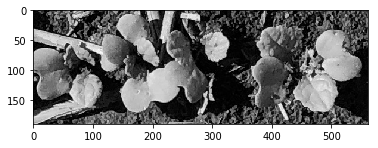

Image File name:IMG_4460.JPG


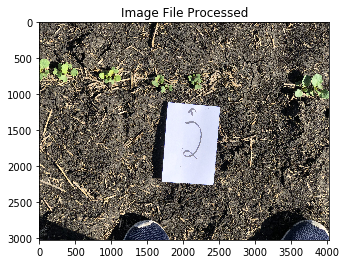

Processed Image: IMG_4460.JPG Number of Labels: 1
Number of Connected Components: 1


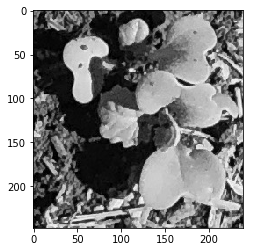

Image File name:IMG_4461.JPG


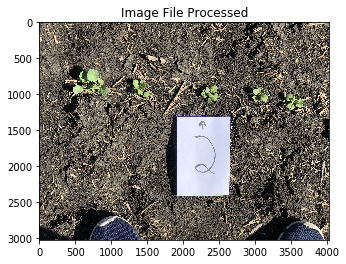

Processed Image: IMG_4461.JPG Number of Labels: 1
Number of Connected Components: 1


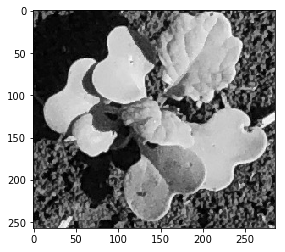

Image File name:IMG_4462.JPG


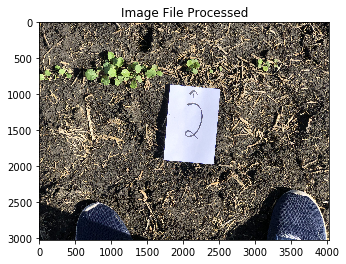

Processed Image: IMG_4462.JPG Number of Labels: 1
Number of Connected Components: 2


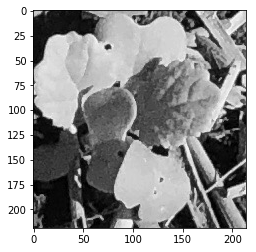

Image File name:IMG_4471.JPG


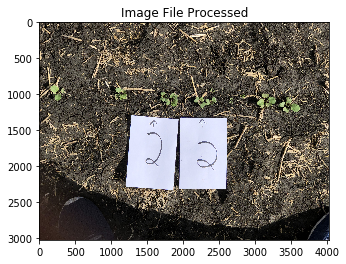

Processed Image: IMG_4471.JPG Number of Labels: 2
Number of Connected Components: 2


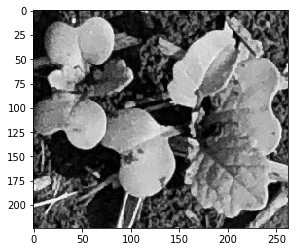

Number of Connected Components: 3


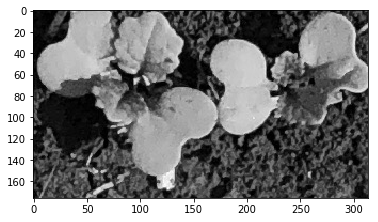

Image File name:IMG_4472.JPG


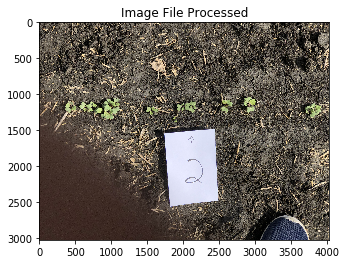

Processed Image: IMG_4472.JPG Number of Labels: 1
Number of Connected Components: 2


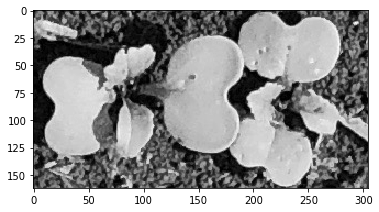

Image File name:IMG_4473.JPG


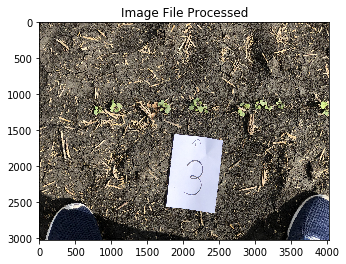

Processed Image: IMG_4473.JPG Number of Labels: 1
Number of Connected Components: 2


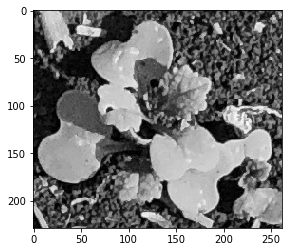

Image File name:IMG_4474.JPG


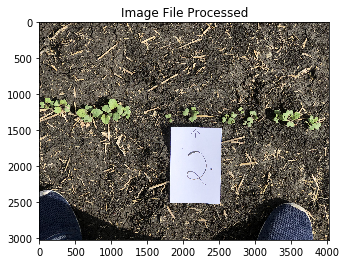

Processed Image: IMG_4474.JPG Number of Labels: 1
Number of Connected Components: 1


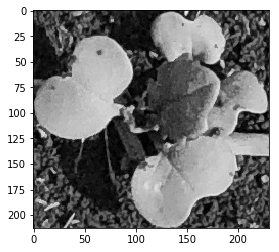

Image File name:IMG_4475.JPG


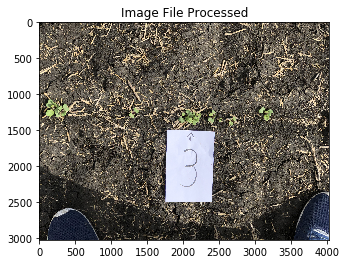

Processed Image: IMG_4475.JPG Number of Labels: 1
Number of Connected Components: 3


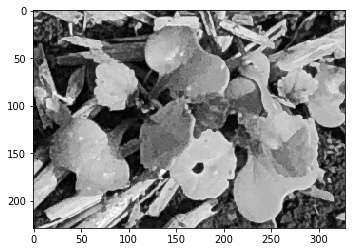

Image File name:IMG_4481.JPG


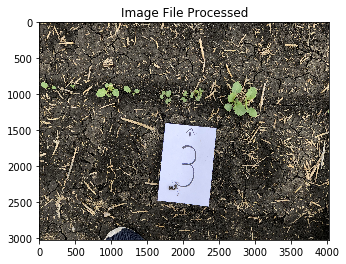

Processed Image: IMG_4481.JPG Number of Labels: 1
Number of Connected Components: 4


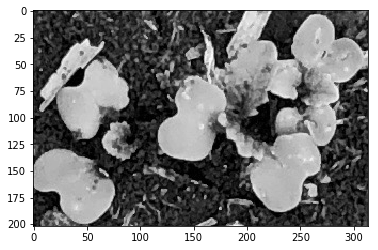

Image File name:IMG_4484.JPG


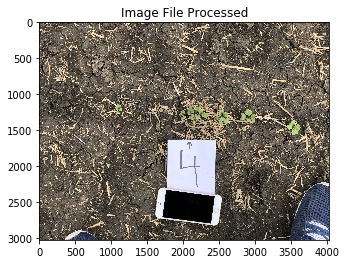

Processed Image: IMG_4484.JPG Number of Labels: 1
Number of Connected Components: 5


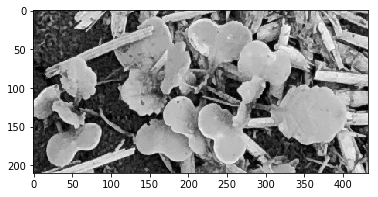

Image File name:IMG_4486.JPG


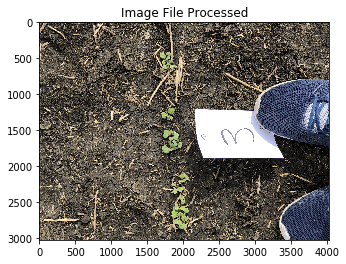

Processed Image: IMG_4486.JPG Number of Labels: 1
Number of Connected Components: 3


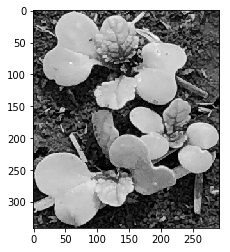

Image File name:IMG_4488.JPG


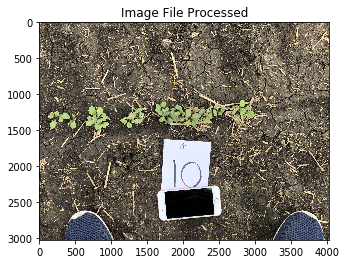

Processed Image: IMG_4488.JPG Number of Labels: 1
Number of Connected Components: 8


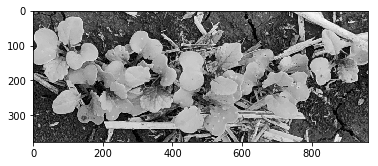

Image File name:IMG_4489.JPG


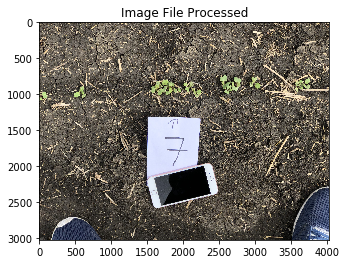

Processed Image: IMG_4489.JPG Number of Labels: 1
Number of Connected Components: 7


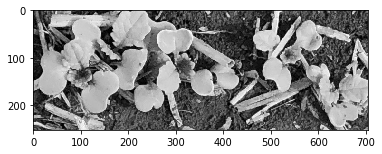

Image File name:IMG_4490.JPG


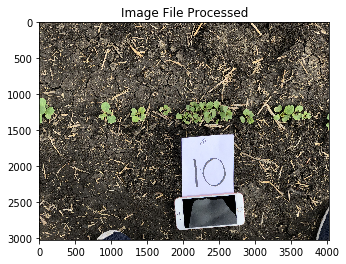

Processed Image: IMG_4490.JPG Number of Labels: 1
Number of Connected Components: 5


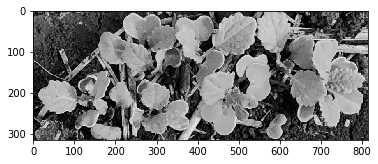

Image File name:IMG_4492.JPG


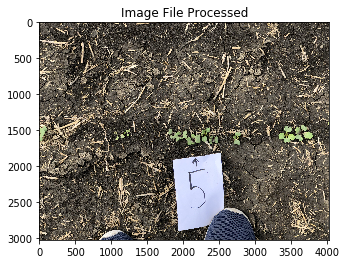

Processed Image: IMG_4492.JPG Number of Labels: 1
Number of Connected Components: 6


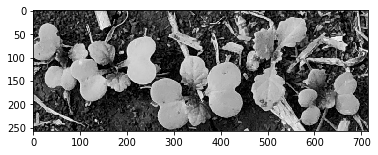

Image File name:IMG_4494.JPG


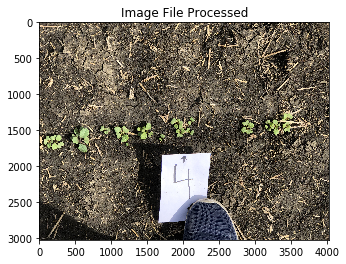

Processed Image: IMG_4494.JPG Number of Labels: 1
Number of Connected Components: 5


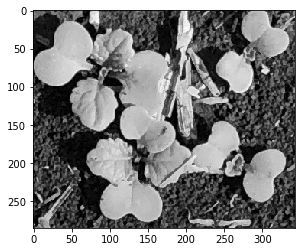

Image File name:IMG_4496.JPG


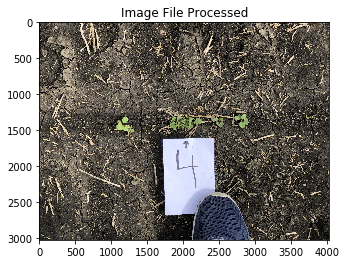

Processed Image: IMG_4496.JPG Number of Labels: 1
Number of Connected Components: 2


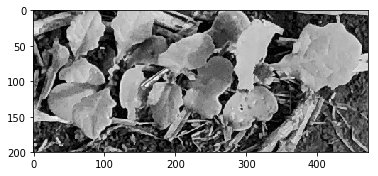

Image File name:IMG_4497.JPG


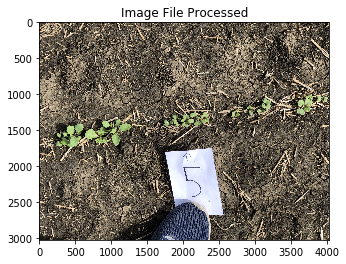

Processed Image: IMG_4497.JPG Number of Labels: 1
Number of Connected Components: 7


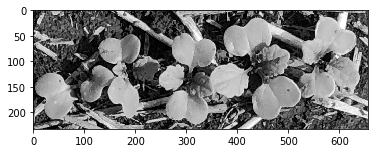

Image File name:IMG_4498.JPG


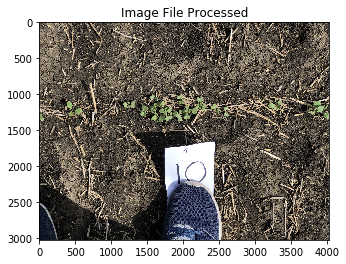

Processed Image: IMG_4498.JPG Number of Labels: 1
Number of Connected Components: 15


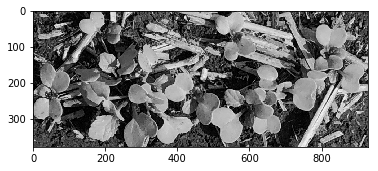

Training Feature Extraction has Completed
Image File name:IMG_4428.JPG


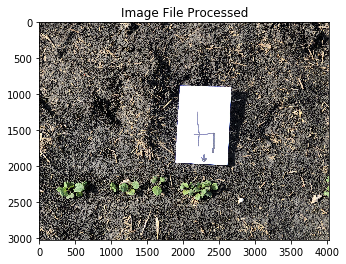

Processed Image: IMG_4428.JPG Number of Labels: 1
Number of Connected Components: 2


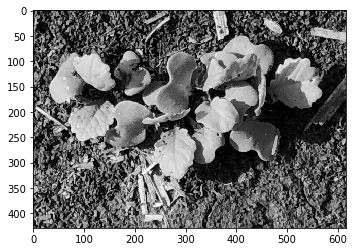

Image File name:IMG_4431.JPG


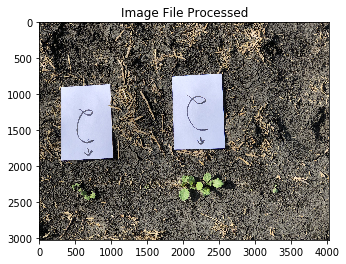

Processed Image: IMG_4431.JPG Number of Labels: 2
Number of Connected Components: 2


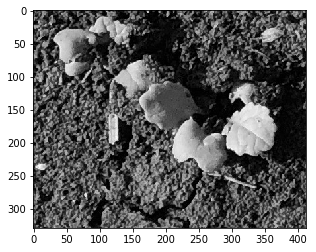

Number of Connected Components: 3


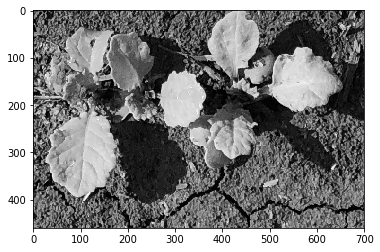

Image File name:IMG_4432.JPG


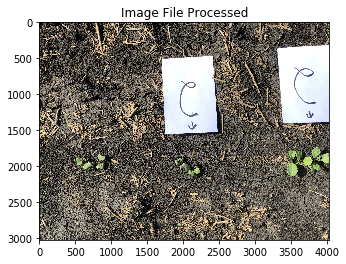

Processed Image: IMG_4432.JPG Number of Labels: 2
Number of Connected Components: 3


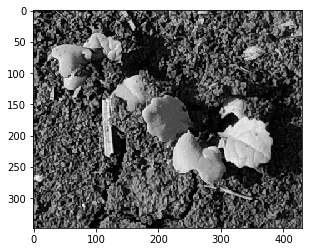

Number of Connected Components: 2


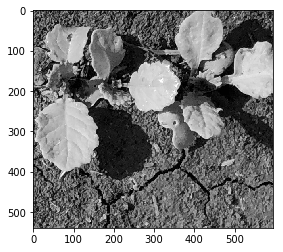

Image File name:IMG_4436.JPG


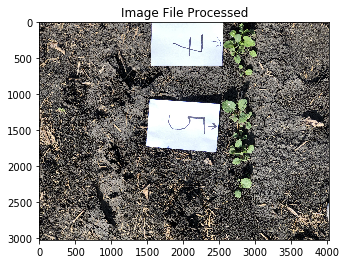

Processed Image: IMG_4436.JPG Number of Labels: 2
Number of Connected Components: 6


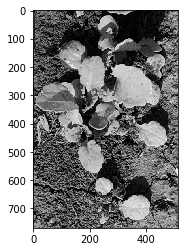

Number of Connected Components: 8


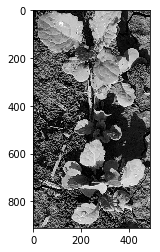

Image File name:IMG_4451.JPG


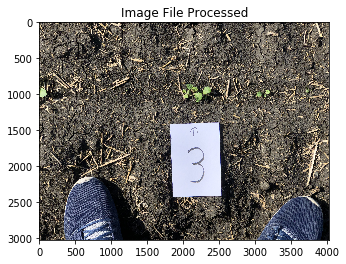

Processed Image: IMG_4451.JPG Number of Labels: 1
Number of Connected Components: 5


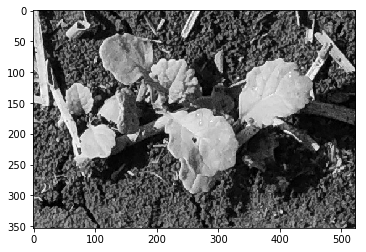

Image File name:IMG_4456.JPG


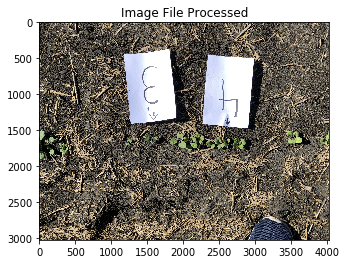

Processed Image: IMG_4456.JPG Number of Labels: 2
Number of Connected Components: 3


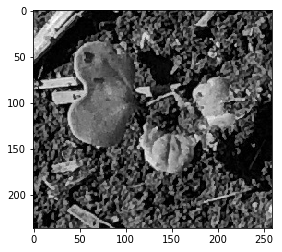

Number of Connected Components: 2


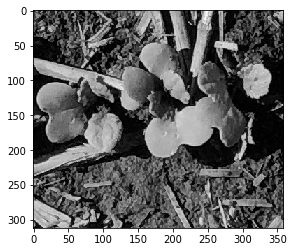

Image File name:IMG_4458.JPG


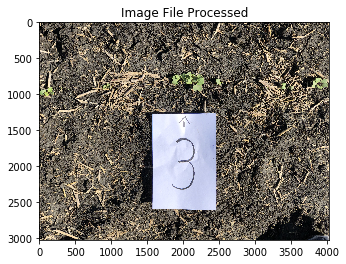

Processed Image: IMG_4458.JPG Number of Labels: 1
Number of Connected Components: 1


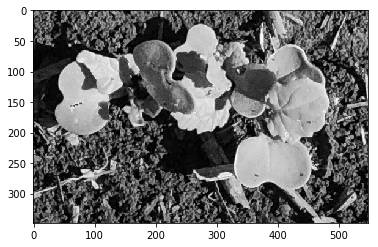

Image File name:IMG_4460.JPG


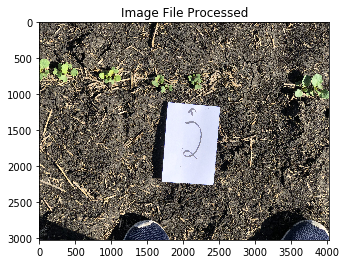

Processed Image: IMG_4460.JPG Number of Labels: 1
Number of Connected Components: 1


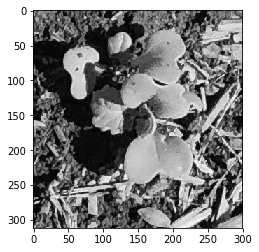

Image File name:IMG_4461.JPG


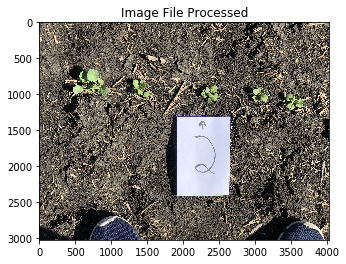

Processed Image: IMG_4461.JPG Number of Labels: 1
Number of Connected Components: 1


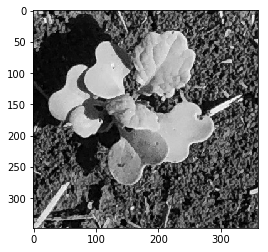

Image File name:IMG_4462.JPG


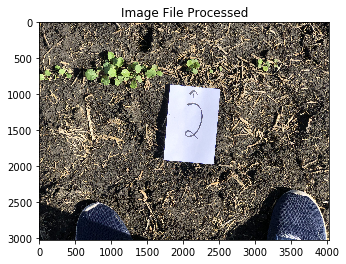

Processed Image: IMG_4462.JPG Number of Labels: 1
Number of Connected Components: 2


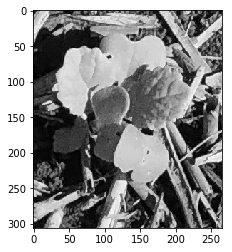

Image File name:IMG_4463.JPG


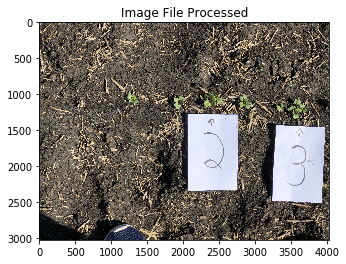

Processed Image: IMG_4463.JPG Number of Labels: 2
Number of Connected Components: 1


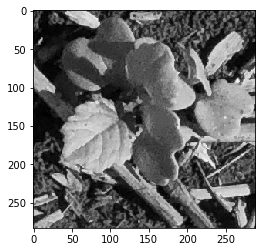

Number of Connected Components: 4


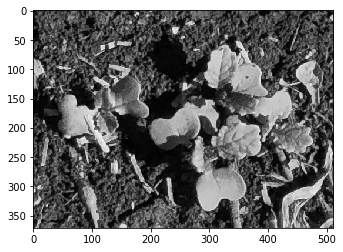

Image File name:IMG_4470.JPG


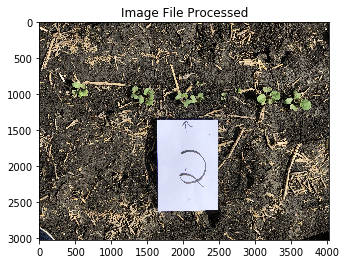

Processed Image: IMG_4470.JPG Number of Labels: 1
Number of Connected Components: 3


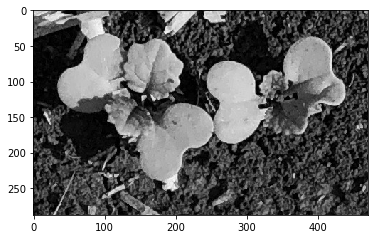

Image File name:IMG_4472.JPG


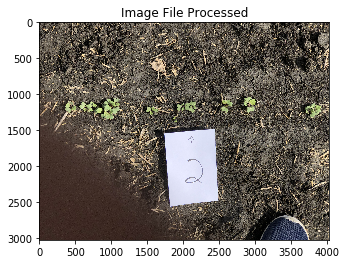

Processed Image: IMG_4472.JPG Number of Labels: 1
Number of Connected Components: 2


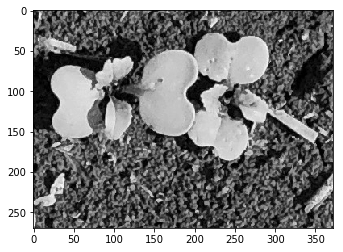

Image File name:IMG_4473.JPG


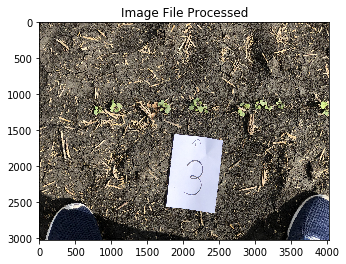

Processed Image: IMG_4473.JPG Number of Labels: 1
Number of Connected Components: 2


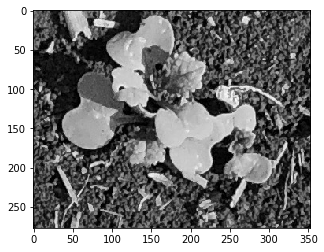

Image File name:IMG_4475.JPG


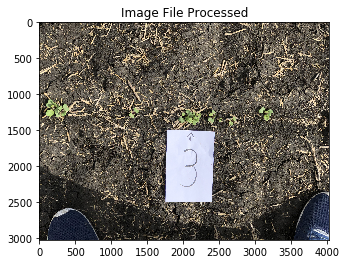

Processed Image: IMG_4475.JPG Number of Labels: 1
Number of Connected Components: 3


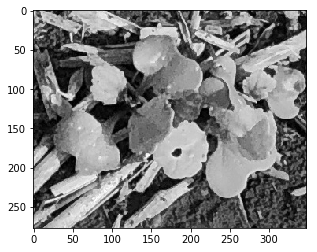

Image File name:IMG_4479.JPG


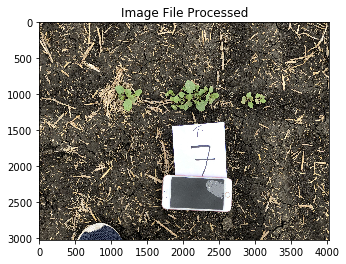

Processed Image: IMG_4479.JPG Number of Labels: 1
Number of Connected Components: 6


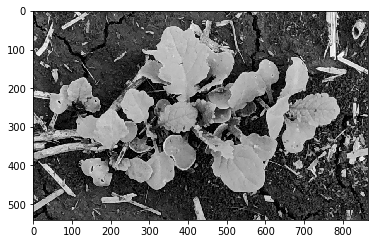

Image File name:IMG_4480.JPG


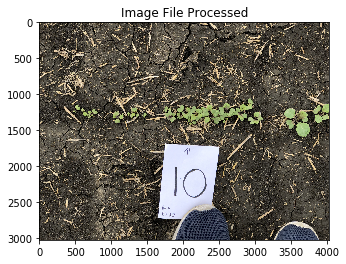

Processed Image: IMG_4480.JPG Number of Labels: 1
Number of Connected Components: 8


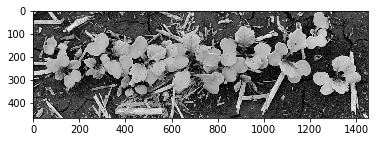

Image File name:IMG_4483.JPG


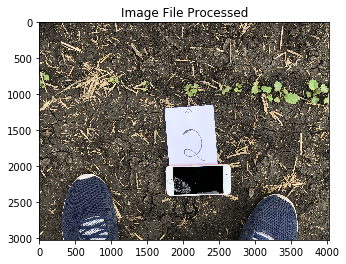

Processed Image: IMG_4483.JPG Number of Labels: 1
Number of Connected Components: 2


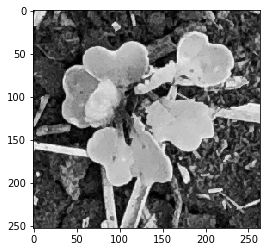

Image File name:IMG_4484.JPG


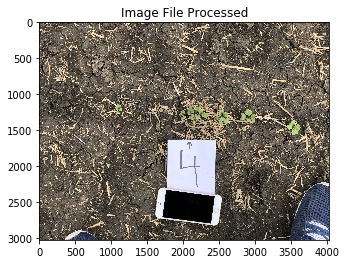

Processed Image: IMG_4484.JPG Number of Labels: 1
Number of Connected Components: 5


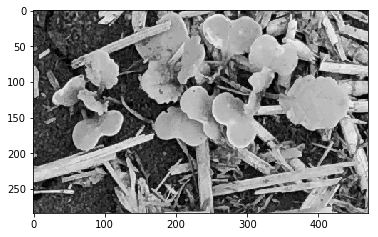

Image File name:IMG_4485.JPG


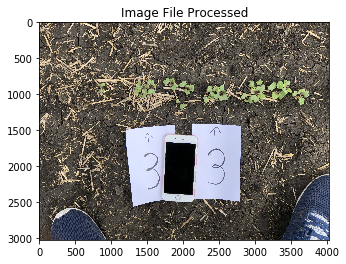

Processed Image: IMG_4485.JPG Number of Labels: 2
Number of Connected Components: 5


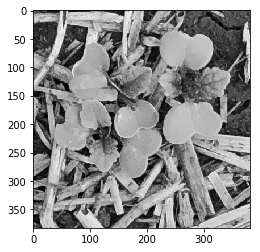

Number of Connected Components: 2


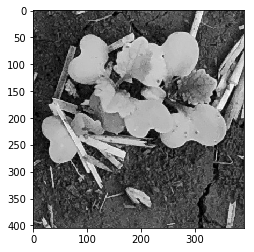

Image File name:IMG_4489.JPG


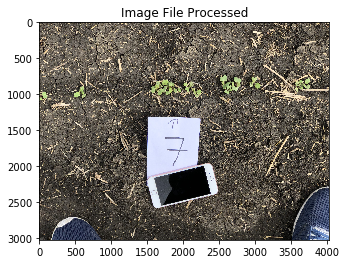

Processed Image: IMG_4489.JPG Number of Labels: 1
Number of Connected Components: 7


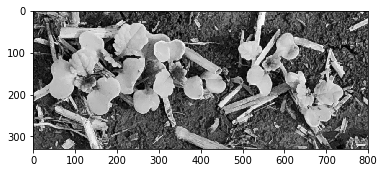

Image File name:IMG_4490.JPG


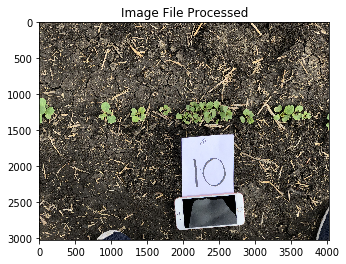

Processed Image: IMG_4490.JPG Number of Labels: 1
Number of Connected Components: 5


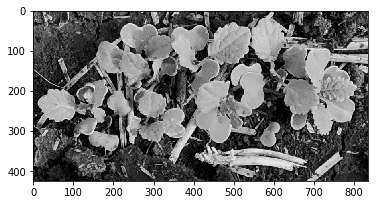

Image File name:IMG_4492.JPG


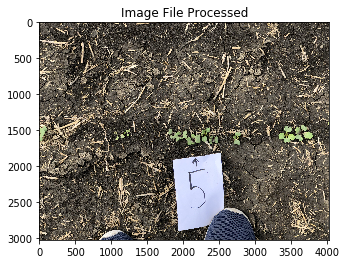

Processed Image: IMG_4492.JPG Number of Labels: 1
Number of Connected Components: 6


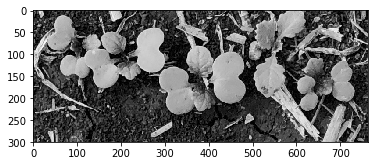

Image File name:IMG_4495.JPG


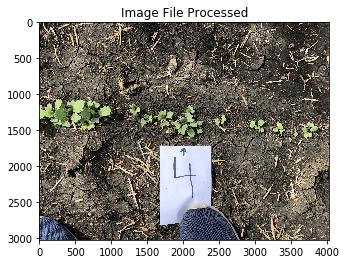

Processed Image: IMG_4495.JPG Number of Labels: 1
Number of Connected Components: 3


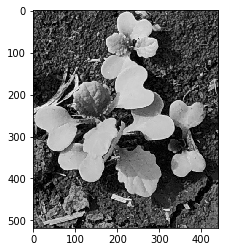

HOCs Testing Feature Extraction has Completed


In [16]:
train_path = os.path.join('.', 'Data/Training')
test_path = os.path.join('.', 'Data/Testing')

training_features_HOCS = []
training_features_GLCM = []
training_features_LBPH = []
training_classes = []
testing_features_HOCS = []
testing_features_GLCM = []
testing_features_LBPH = []
test_classes =[]

if not os.path.exists(train_path) or not os.path.exists(test_path):
    print("Directory Doesn't Exist\nExiting the Program")


for root, dirs, files in os.walk(train_path):
    for filename in files:
        cropped_images,image_labels = c.cropped_bounding_boxes(train_path,filename)
        print("Processed Image: "+str(filename) +" Number of Labels: "+str(len(image_labels)))
        for x in range(0,len(image_labels)):
            training_features_HOCS.append(regional_statistics(segment_clump(cropped_images[x])))
            training_features_GLCM.append(GLCM_feature(cropped_images[x]))
            training_features_LBPH.append(get_LBP(cropped_images[x]))
            training_classes.append(image_labels[x])
            
print("Training Feature Extraction has Completed")


for root, dirs, files in os.walk(test_path):
    for filename in files:
        cropped_images,image_labels = c.cropped_bounding_boxes(test_path,filename)
        print("Processed Image: "+str(filename) +" Number of Labels: "+str(len(image_labels)))
        for x in range(0,len(image_labels)):
            testing_features_HOCS.append(regional_statistics(segment_clump(cropped_images[x])))
            testing_features_GLCM.append(GLCM_feature(cropped_images[x]))
            testing_features_LBPH.append(get_LBP(cropped_images[x]))
            test_classes.append(image_labels[x])
            
print("HOCs Testing Feature Extraction has Completed")


# Training and Testing Knn Classifier

In [17]:
model = KNeighborsClassifier(n_neighbors=1)
model.fit(training_features_HOCS,training_classes)
predicted_classes = model.predict(testing_features_HOCS)
print("HOCS Confusion Matrix")
print(confusion_matrix(test_classes, predicted_classes))
print("HOCS Accuracy Score")
print(accuracy_score(test_classes,predicted_classes))


model = KNeighborsClassifier(n_neighbors=1)
model.fit(training_features_GLCM,training_classes)
predicted_classes = model.predict(testing_features_GLCM)
print("\nGLCM Confusion Matrix")
print(confusion_matrix(test_classes, predicted_classes))
print("GLCM Accuracy Score")
print(accuracy_score(test_classes,predicted_classes))


model = KNeighborsClassifier(n_neighbors=1)
model.fit(training_features_LBPH,training_classes)
predicted_classes = model.predict(testing_features_LBPH)
print("\nLBPH Confusion Matrix")
print(confusion_matrix(test_classes, predicted_classes))
print("LPBH Accuracy Score")
print(accuracy_score(test_classes,predicted_classes))

HOCS Confusion Matrix
[[4 0 4 0 0 3 0]
 [1 3 3 0 0 0 1]
 [0 0 2 0 0 1 0]
 [0 0 0 2 0 0 0]
 [0 0 1 0 0 0 0]
 [0 0 1 1 0 1 0]
 [0 0 0 0 0 0 2]]
HOCS Accuracy Score
0.4666666666666667

GLCM Confusion Matrix
[[1 4 3 2 0 0 1]
 [0 2 3 1 0 0 2]
 [0 0 2 1 0 0 0]
 [0 0 0 1 0 0 1]
 [0 0 1 0 0 0 0]
 [1 1 0 0 0 0 1]
 [0 1 0 0 0 0 1]]
GLCM Accuracy Score
0.23333333333333334

LBPH Confusion Matrix
[[0 6 4 1 0 0 0]
 [0 1 3 4 0 0 0]
 [0 1 1 1 0 0 0]
 [0 0 0 2 0 0 0]
 [0 1 0 0 0 0 0]
 [0 1 0 1 0 0 1]
 [0 0 0 0 0 0 2]]
LPBH Accuracy Score
0.2


# Training and Testing SVM Classifier

In [18]:
svm_rbf = svm.SVC(kernel='rbf', C=0.001)
svm_rbf.fit(training_features_HOCS,training_classes)
rbf_predicted_classes = svm_rbf.predict(testing_features_HOCS)
print("\n\nHOCS Confusion Matrix")
print(confusion_matrix(test_classes, rbf_predicted_classes))
print("HOCS Accuracy Score")
print(accuracy_score(test_classes,rbf_predicted_classes))


svm_rbf = svm.SVC(kernel='rbf', C=0.001)
svm_rbf.fit(training_features_GLCM,training_classes)
rbf_predicted_classes = svm_rbf.predict(testing_features_GLCM)
print("\nGLCM Confusion Matrix")
print(confusion_matrix(test_classes, rbf_predicted_classes))
print("GLCM Accuracy Score")
print(accuracy_score(test_classes,rbf_predicted_classes))


svm_rbf = svm.SVC(kernel='rbf', C=0.001)
svm_rbf.fit(training_features_LBPH,training_classes)
rbf_predicted_classes = svm_rbf.predict(testing_features_LBPH)
print("\nLBPH Confusion Matrix")
print(confusion_matrix(test_classes, rbf_predicted_classes))
print("LBPH Accuracy Score")
print(accuracy_score(test_classes,rbf_predicted_classes))



HOCS Confusion Matrix
[[ 0  0 11  0  0  0  0]
 [ 0  0  8  0  0  0  0]
 [ 0  0  3  0  0  0  0]
 [ 0  0  2  0  0  0  0]
 [ 0  0  1  0  0  0  0]
 [ 0  0  3  0  0  0  0]
 [ 0  0  2  0  0  0  0]]
HOCS Accuracy Score
0.1

GLCM Confusion Matrix
[[ 0  0 11  0  0  0  0]
 [ 0  0  8  0  0  0  0]
 [ 0  0  3  0  0  0  0]
 [ 0  0  2  0  0  0  0]
 [ 0  0  1  0  0  0  0]
 [ 0  0  3  0  0  0  0]
 [ 0  0  2  0  0  0  0]]
GLCM Accuracy Score
0.1

LBPH Confusion Matrix
[[ 0  0 11  0  0  0  0]
 [ 0  0  8  0  0  0  0]
 [ 0  0  3  0  0  0  0]
 [ 0  0  2  0  0  0  0]
 [ 0  0  1  0  0  0  0]
 [ 0  0  3  0  0  0  0]
 [ 0  0  2  0  0  0  0]]
LBPH Accuracy Score
0.1


# Training and Testing GaussianNB

In [19]:
gnb = GaussianNB()
gnb.fit(training_features_HOCS,training_classes)
gnb_predicted_classes = gnb.predict(testing_features_HOCS)
print("\n\nHOCS Confusion Matrix")
print(confusion_matrix(test_classes, gnb_predicted_classes))
print("HOCS Accuracy Score")
print(accuracy_score(test_classes,gnb_predicted_classes))


gnb = GaussianNB()
gnb.fit(training_features_GLCM,training_classes)
gnb_predicted_classes = gnb.predict(testing_features_GLCM)
print("\nGLCM Confusion Matrix")
print(confusion_matrix(test_classes, gnb_predicted_classes))
print("GLCM Accuracy Score")
print(accuracy_score(test_classes,gnb_predicted_classes))


gnb = GaussianNB()
gnb.fit(training_features_LBPH,training_classes)
gnb_predicted_classes = gnb.predict(testing_features_LBPH)
print("\nLBPH Confusion Matrix")
print(confusion_matrix(test_classes, gnb_predicted_classes))
print("LBPH Accuracy Score")
print(accuracy_score(test_classes,gnb_predicted_classes))



HOCS Confusion Matrix
[[8 2 0 0 0 1 0]
 [3 3 0 0 0 2 0]
 [1 2 0 0 0 0 0]
 [0 0 0 2 0 0 0]
 [1 0 0 0 0 0 0]
 [0 1 0 2 0 0 0]
 [0 1 0 1 0 0 0]]
HOCS Accuracy Score
0.43333333333333335

GLCM Confusion Matrix
[[1 3 2 2 0 0 3]
 [0 3 1 1 0 0 3]
 [0 2 0 0 0 0 1]
 [0 0 0 1 0 0 1]
 [0 0 1 0 0 0 0]
 [0 0 0 1 0 0 2]
 [0 0 0 0 0 0 2]]
GLCM Accuracy Score
0.23333333333333334

LBPH Confusion Matrix
[[6 3 0 2 0 0 0]
 [3 2 0 0 0 3 0]
 [2 0 0 0 0 1 0]
 [0 0 0 0 0 1 1]
 [0 0 0 0 0 1 0]
 [0 0 0 0 0 1 2]
 [0 0 0 1 0 0 1]]
LBPH Accuracy Score
0.3333333333333333


In [ ]:
#cropped_images,image_labels = c.cropped_bounding_boxes('Umair','IMG_4456.JPG')
cropped_images,image_labels = c.cropped_bounding_boxes('Data/Testing','IMG_4463.JPG')
#cropped_images,image_labels = c.cropped_bounding_boxes('Umair/Training','IMG_4430.JPG')
# for x in range(0,len(image_labels)):
#     plt.figure()
#     plt.title("Clump Count:"+str(image_labels[x]))
#     plt.imshow(cropped_images[x])
#     plt.figure()
#     segmented_image = segment_clump(cropped_images[x])
#     predicted_count = regional_statistics(segmented_image)
#     plt.title("Actual Clump Count:"+str(image_labels[x])+" Predicted Count:"+str(predicted_count))
#     plt.imshow(segmented_image)
#     plt.figure()
#     plt.title("Actual Clump Count:"+str(image_labels[x])+" Predicted Count:"+str(predicted_count))
#     plt.imshow(seg.mark_boundaries(cropped_images[x],segmented_image,color=(1,0,0),outline_color=(1,0,0)))
    
    
# #grey_scaled = cl.rgb2gray(cropped_images[1])
# plt.hist((cropped_images[1]).ravel(),bins=257,range=(0,256))
# plt.show()
# plt.figure()
# plt.imshow(grey_scaled)
# #print(grey_scaled[:10,:])
# plt.figure()
# plt.imshow(cropped_images[0][:,:,0])